In [1]:
import os
from PIL import Image
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

class PairedImageDataset(Dataset):
    def __init__(self, comp_dir, lg_dir, transform=None):
        self.comp_dir = comp_dir
        self.lg_dir = lg_dir
        self.transform = transform
        self.image_names = os.listdir(comp_dir)

    def __len__(self):
        return len(self.image_names)

    def __getitem__(self, idx):
        img_name = self.image_names[idx]
        comp_img_path = os.path.join(self.comp_dir, img_name)
        lg_img_path = os.path.join(self.lg_dir, img_name)

        comp_image = Image.open(comp_img_path).convert('L')
        lg_image = Image.open(lg_img_path).convert('L')

        if self.transform:
            comp_image = self.transform(comp_image)
            lg_image = self.transform(lg_image)

        return comp_image, lg_image

# Define the transform
transform = transforms.Compose([
    transforms.Resize((64, 2048)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))  # Normalize images to [-1, 1]
])

# Create the dataset and dataloader
comp_dir = '/Selected_Comp'
lg_dir = '/Selected_LG'

dataset = PairedImageDataset(comp_dir, lg_dir, transform=transform)
dataloader = DataLoader(dataset, batch_size=4, shuffle=True, num_workers=4)


Using 16bit Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name         | Type        | Params | Mode 
-----------------------------------------------------
0 | generator    | UNet2DModel | 290 M  | train
1 | criterion_l1 | L1Loss      | 0      | train
-----------------------------------------------------
290 M     Trainable params
0         Non-trainable params
290 M     Total params
1,161.246 Total estimated model params size (MB)
/opt/conda/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=63` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

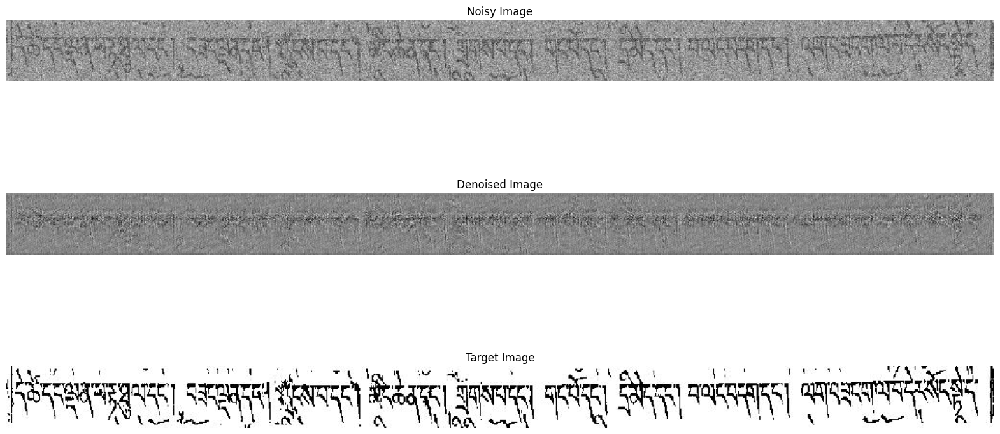

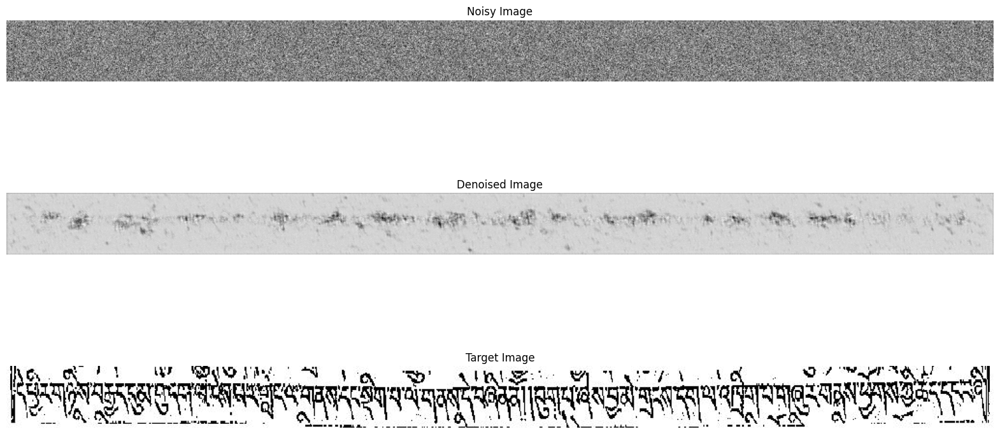

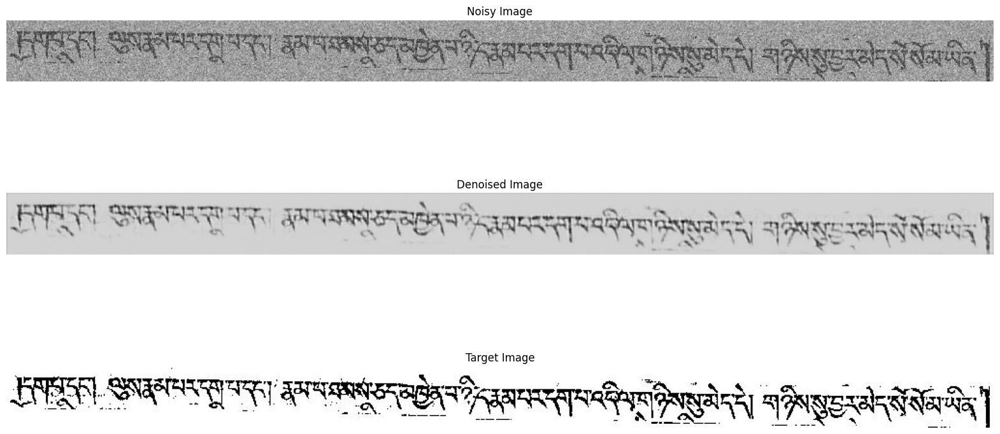

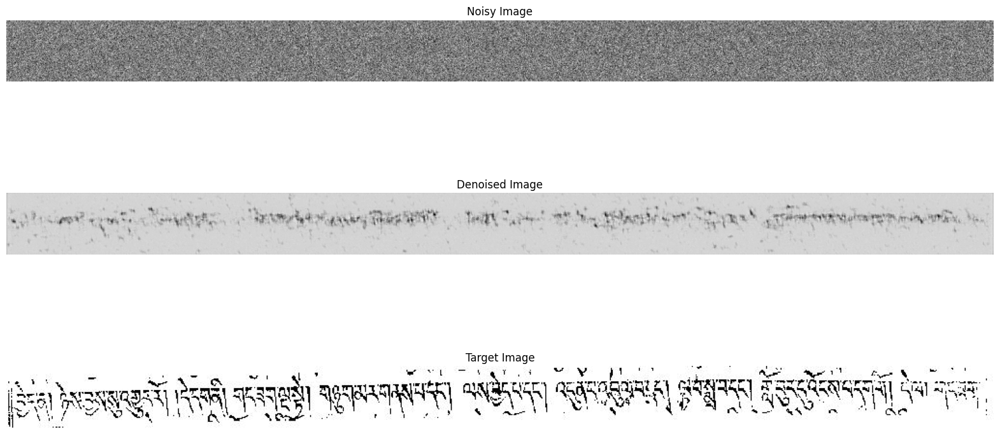

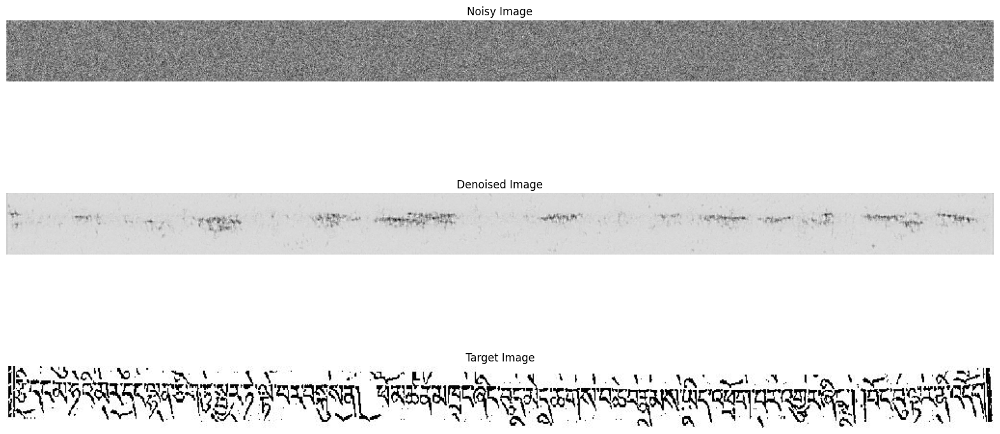

...

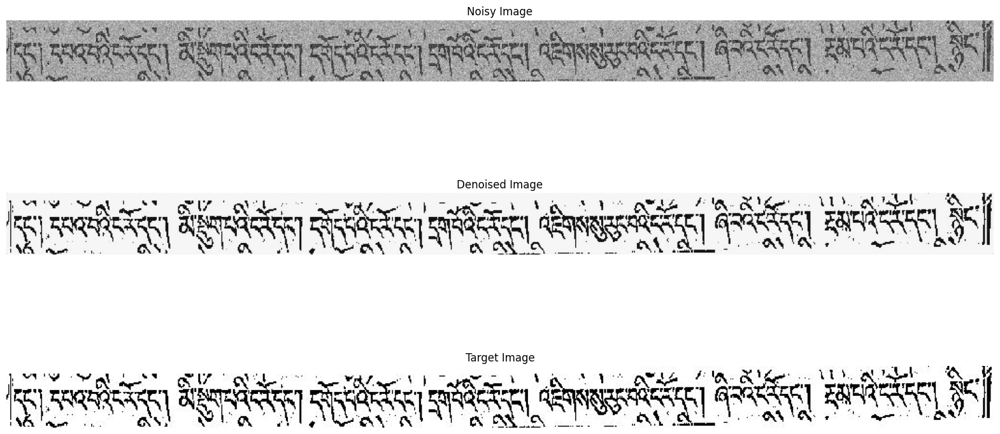

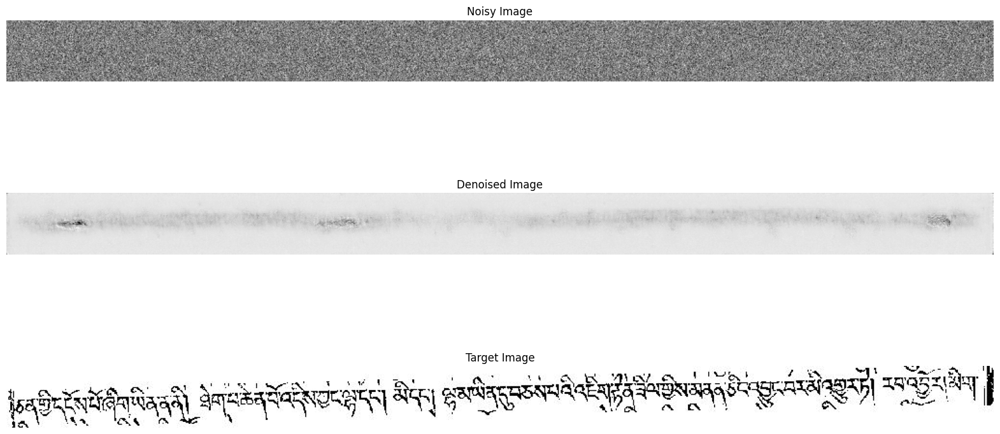

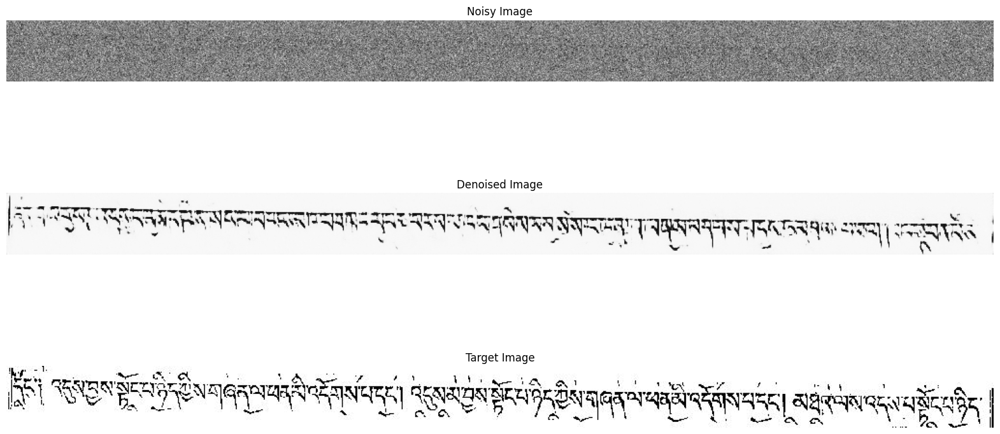

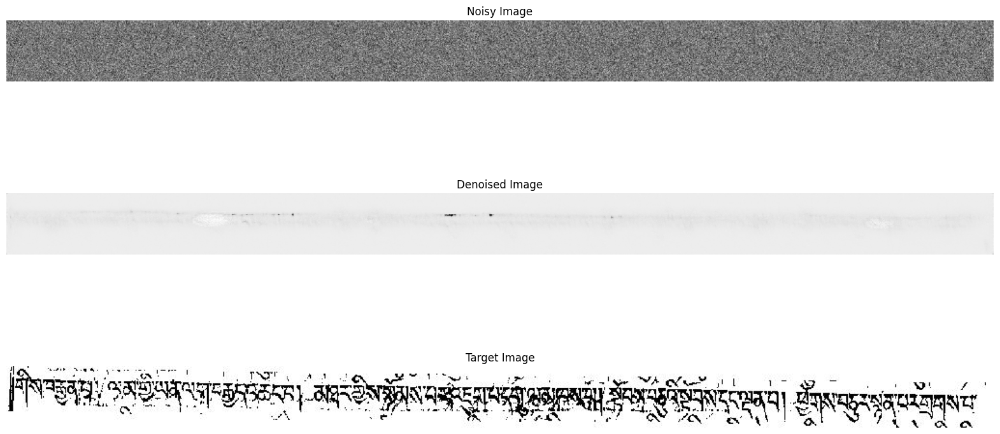

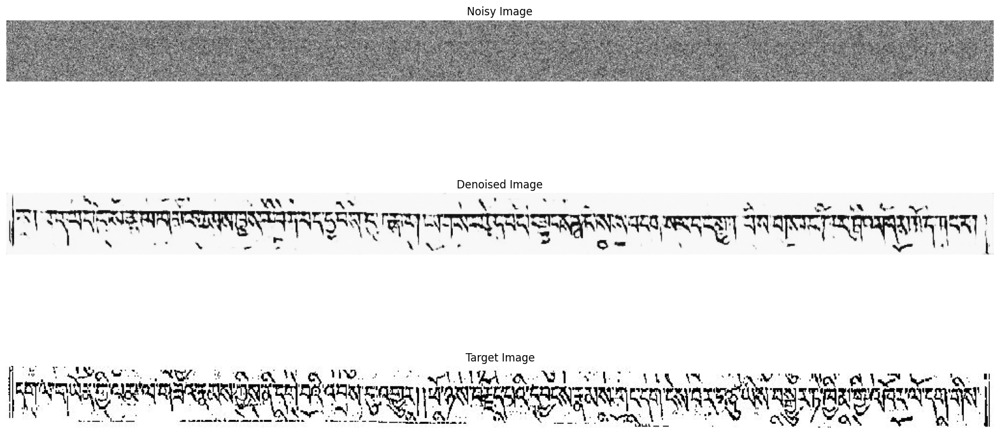

In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
from torchvision.transforms.functional import resize
import pytorch_lightning as pl
from pytorch_lightning import Trainer
from pytorch_lightning.callbacks import LearningRateMonitor
from diffusers import UNet2DModel, DDPMScheduler
from PIL import Image
import matplotlib.pyplot as plt
import random

class CustomDataset(Dataset):
    def __init__(self, comp_dir, lg_dir, transform=None):
        self.comp_dir = comp_dir
        self.lg_dir = lg_dir
        self.transform = transform
        self.file_names = [f for f in os.listdir(comp_dir) if os.path.isfile(os.path.join(comp_dir, f))]

    def __len__(self):
        return len(self.file_names)

    def __getitem__(self, idx):
        comp_image = Image.open(os.path.join(self.comp_dir, self.file_names[idx])).convert('L')
        lg_image = Image.open(os.path.join(self.lg_dir, self.file_names[idx])).convert('L')

        if self.transform:
            comp_image = self.transform(comp_image)
            lg_image = self.transform(lg_image)

        return comp_image, lg_image

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

comp_dir = '/Selected_Comp'
lg_dir = '/Selected_LG'
dataset = CustomDataset(comp_dir, lg_dir, transform)
dataloader = DataLoader(dataset, batch_size=4, shuffle=True)

class ImageToImageDDPM(pl.LightningModule):
    def __init__(self):
        super(ImageToImageDDPM, self).__init__()
        self.generator = UNet2DModel(
            sample_size=(64, 2048),
            in_channels=2,  # Two channels: one for the noisy image, one for the condition image
            out_channels=1,  # Single channel output for grayscale images
            layers_per_block=3,
            block_out_channels=(64, 128, 256, 512, 1024),
            down_block_types=("DownBlock2D", "DownBlock2D", "DownBlock2D", "DownBlock2D", "DownBlock2D"),
            up_block_types=("UpBlock2D", "UpBlock2D", "UpBlock2D", "UpBlock2D", "UpBlock2D")
        )
        self.scheduler = DDPMScheduler(num_train_timesteps=1000)
        self.criterion_l1 = nn.L1Loss()

    def forward(self, x, t, condition):
        condition = resize(condition, x.shape[2:])
        combined_input = torch.cat([x, condition], dim=1)
        return self.generator(combined_input, t).sample

    def configure_optimizers(self):
        optimizer = optim.Adam(self.parameters(), lr=1e-4)
        return optimizer

    def training_step(self, batch, batch_idx):
        comp_images, lg_images = batch
        t = torch.randint(0, self.scheduler.config.num_train_timesteps, (comp_images.size(0),), device=self.device).long()
        noise = torch.randn_like(lg_images).to(self.device)
        noisy_images = self.scheduler.add_noise(lg_images, noise, t)
        denoised_images = self(noisy_images, t, comp_images)

        loss = self.criterion_l1(denoised_images, lg_images)
        self.log('train_loss', loss)

        # Print intermediate results every 100 batches
        if batch_idx % 100 == 0:
            self.print_intermediate_results(noisy_images, denoised_images, lg_images)

        return loss

    def print_intermediate_results(self, noisy_images, denoised_images, lg_images):
        noisy_images = (noisy_images + 1) / 2  # Convert from [-1, 1] to [0, 1]
        denoised_images = (denoised_images + 1) / 2
        lg_images = (lg_images + 1) / 2

        fig, axs = plt.subplots(3, 1, figsize=(20, 10))

        axs[0].imshow(noisy_images[0].cpu().detach().squeeze(), cmap='gray')
        axs[0].set_title('Noisy Image')
        axs[0].axis('off')

        axs[1].imshow(denoised_images[0].cpu().detach().squeeze(), cmap='gray')
        axs[1].set_title('Denoised Image')
        axs[1].axis('off')

        axs[2].imshow(lg_images[0].cpu().detach().squeeze(), cmap='gray')
        axs[2].set_title('Target Image')
        axs[2].axis('off')

        plt.show()

# Training the model
trainer = Trainer(
    default_root_dir='my_custom_logs',  # Custom directory for logs
    precision=16,  # Mixed precision
    accumulate_grad_batches=4,  # Gradient accumulation
    max_epochs=50,  # Number of epochs
    devices=1,
    callbacks=[LearningRateMonitor(logging_interval='epoch')]  # Monitor learning rate
)

model = ImageToImageDDPM()
trainer.fit(model, dataloader)


In [ ]:
# Generating images
model.eval()
with torch.no_grad():
    # Select a random image from the dataset for conditioning
    random_idx = random.randint(0, len(dataset) - 1)
    comp_image, _ = dataset[random_idx]
    comp_image = comp_image.unsqueeze(0).to('cuda')  # Add batch dimension and move to GPU

    # Resize the input image to match the model's expected input size
    comp_image = resize(comp_image, (64, 2048))

    num_images = 1  # Generate one image conditioned on the input
    noise = torch.randn(num_images, 1, 64, 2048).to('cuda')  # Initial noise
    for t in reversed(range(model.scheduler.config.num_train_timesteps)):
        model_output = model(noise, t, comp_image)
        noise = model.scheduler.step(model_output, t, noise).prev_sample

    generated_image = (noise + 1) / 2  # Convert [-1, 1] to [0, 1]

# Plot the input image and the generated image
plt.figure(figsize=(20, 10))

# Input image (Computer Font)
plt.subplot(2, 1, 1)
plt.imshow(comp_image.squeeze().cpu().detach(), cmap='gray')
plt.title('Input Image (Computer Font)')
plt.axis("off")

# Generated image (LG Style)
plt.subplot(2, 1, 2)
plt.imshow(generated_image.squeeze().cpu().detach(), cmap='gray')
plt.title('Generated Image (LG Style)')
plt.axis("off")

plt.show()
